In [1]:
from google.colab import drive
import os
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip /content/drive/MyDrive/Colab/類神經/期末專題/dataset_v2.zip

Archive:  /content/drive/MyDrive/Colab/類神經/期末專題/dataset_v2.zip
   creating: dataset_v2/
   creating: dataset_v2/test/
  inflating: dataset_v2/test/dataset.json  
   creating: dataset_v2/test/img/
  inflating: dataset_v2/test/img/20211206_125104.jpg  
  inflating: dataset_v2/test/img/20211206_125155.jpg  
  inflating: dataset_v2/test/img/20211206_125246.jpg  
  inflating: dataset_v2/test/img/20211206_125336.jpg  
  inflating: dataset_v2/test/img/20211206_125432.jpg  
  inflating: dataset_v2/test/img/20211206_125521.jpg  
  inflating: dataset_v2/test/img/20211206_125629.jpg  
  inflating: dataset_v2/test/img/20211206_130453.jpg  
  inflating: dataset_v2/test/img/20211206_130537.jpg  
  inflating: dataset_v2/test/img/20211206_130623.jpg  
  inflating: dataset_v2/test/img/20211206_130701.jpg  
  inflating: dataset_v2/test/img/20211206_130728.jpg  
  inflating: dataset_v2/test/img/20211206_130909.jpg  
  inflating: dataset_v2/test/img/20211206_131652.jpg  
  inflating: dataset_v2/test/img/2

In [3]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-0kdnspf4
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-0kdnspf4
  Resolved https://github.com/facebookresearch/detectron2.git to commit 857d5de21a7789d1bba46694cf608b1cb2ea128a
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 KB 7.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 KB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.1/154.1 KB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 57.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 549.1/549.1 KB 48.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 KB 18.0 MB/s eta 0:00:

#產生result檔

In [4]:
import pycocotools
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval
import sys
from io import StringIO
import json
import cv2
import numpy as np
import warnings
warnings.simplefilter("ignore")
#----------------------------------------------#
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor
#----------------------------------------------#

# Path to test annotation
path_to_annotation = '/content/dataset_v2/test/dataset.json'
test_img_dir = r'/content/dataset_v2/test/img'

cocoGt = COCO(path_to_annotation)

# Initial your model here
cfg = get_cfg()
cfg.merge_from_file("/content/drive/MyDrive/Colab/類神經/期末專題/output/MaskRCNN_R50_7000/output.yaml")  #output的.yaml檔
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab/類神經/期末專題/output/MaskRCNN_R50_7000/model_final.pth"  #weight檔

predictor = DefaultPredictor(cfg)

# Predict and save the result to COCO format
summary = []
for _, data in cocoGt.imgs.items():
    test_img_path = os.path.join(test_img_dir, data['file_name'])
    im = cv2.imread(test_img_path)
    
    # Modified by your model prediction method here
    outputs = predictor(im)
    pred = outputs['instances'].to('cpu')

    if len(pred) > 0:
        category = pred.get('pred_classes').numpy()
        pred_masks = pred.get('pred_masks').numpy()
        scores = pred.get('scores').numpy()
        bbox = pred.get('pred_boxes').tensor.numpy()

    for c, m ,s, b in zip(category, pred_masks, scores, bbox):
        m = pycocotools.mask.encode(np.asarray(m, order="F"))
        m['counts'] = m['counts'].decode('utf-8')

        summary.append({
        'image_id': int(data['id']),
        'category_id': int(c) + 1,
        'score': float(s),
        'segmentation': m
        })

with open('/content/drive/MyDrive/Colab/類神經/期末專題/result_v2_7000.json', 'w') as json_file:
    json.dump(summary, json_file)

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


#預測結果與原始圖片

## Resnet101_7000

file name:  ./dataset_v2/test/img/20211206_125104.jpg
image number:  1


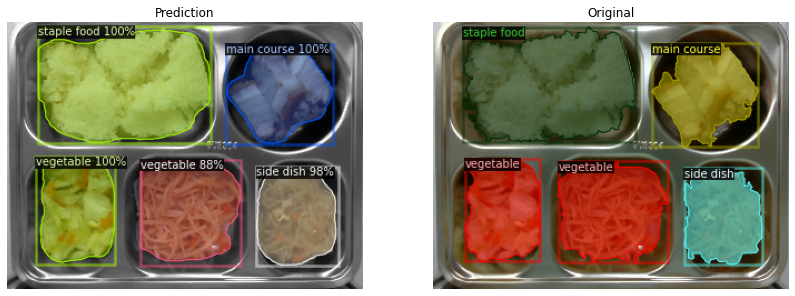

file name:  ./dataset_v2/test/img/20211206_125155.jpg
image number:  2


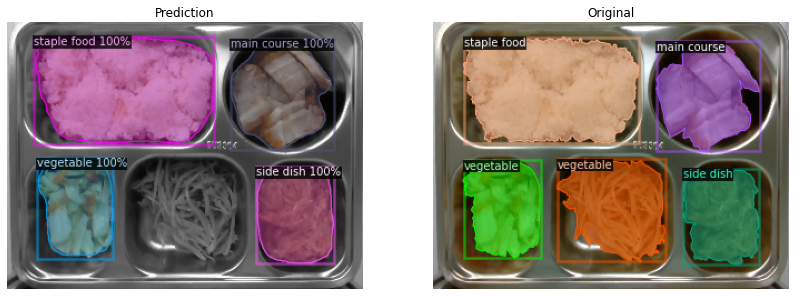

file name:  ./dataset_v2/test/img/20211206_125246.jpg
image number:  3


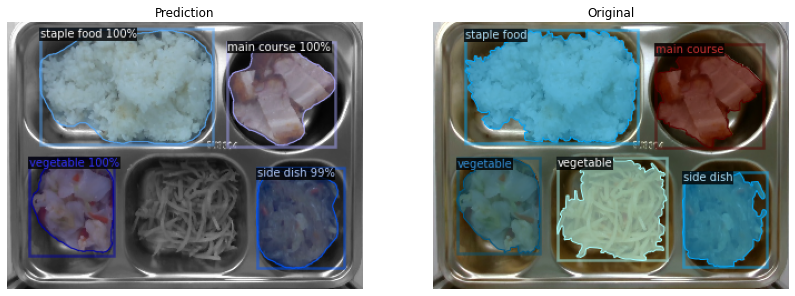

file name:  ./dataset_v2/test/img/20211206_125336.jpg
image number:  4


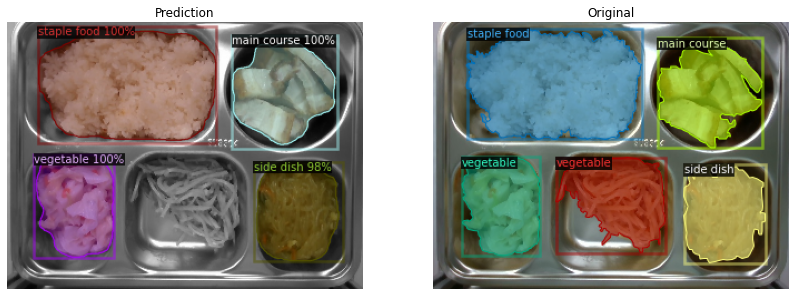

file name:  ./dataset_v2/test/img/20211206_125432.jpg
image number:  5


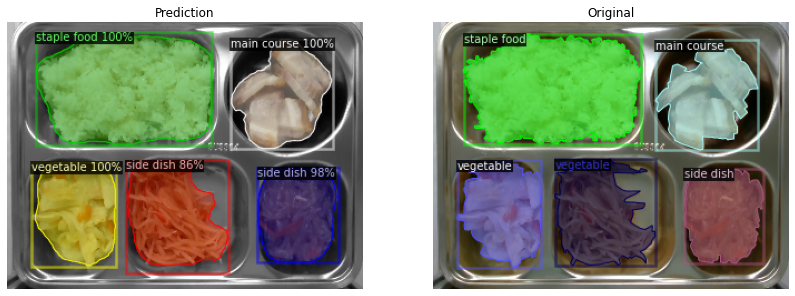

file name:  ./dataset_v2/test/img/20211206_125521.jpg
image number:  6


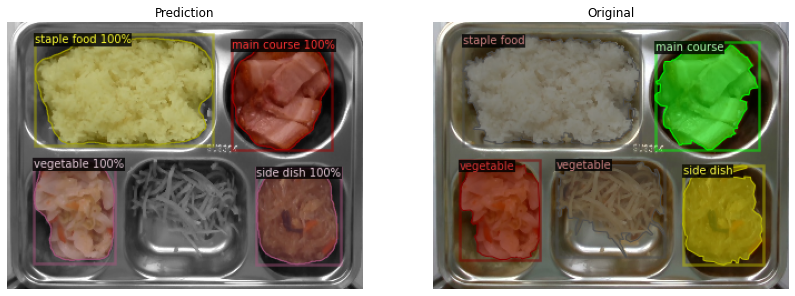

file name:  ./dataset_v2/test/img/20211206_125629.jpg
image number:  7


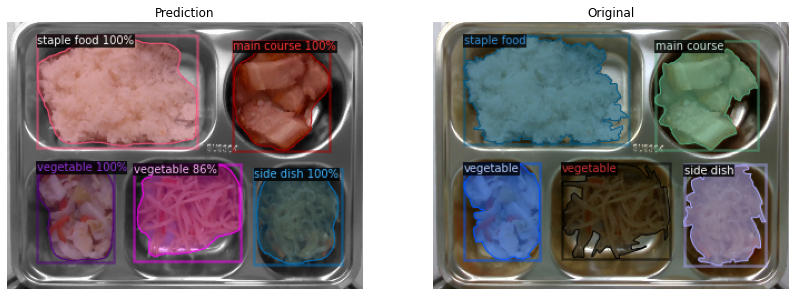

file name:  ./dataset_v2/test/img/20211206_130453.jpg
image number:  8


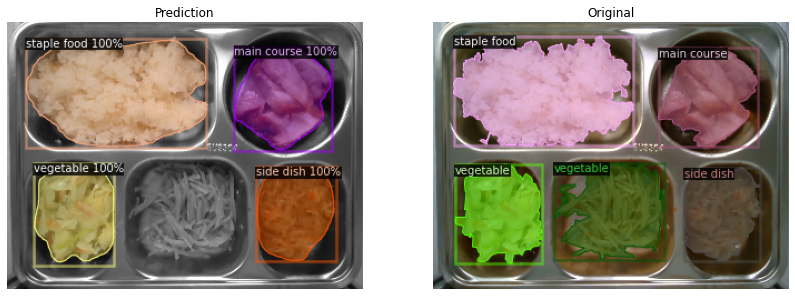

file name:  ./dataset_v2/test/img/20211206_130537.jpg
image number:  9


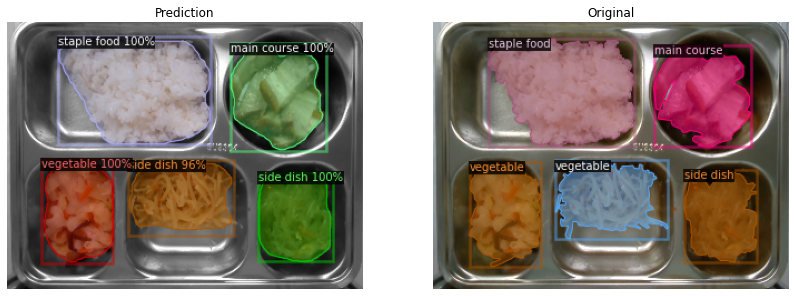

file name:  ./dataset_v2/test/img/20211206_130623.jpg
image number:  10


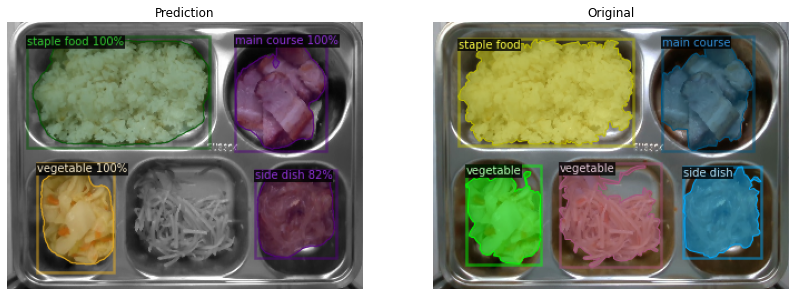

file name:  ./dataset_v2/test/img/20211206_130701.jpg
image number:  11


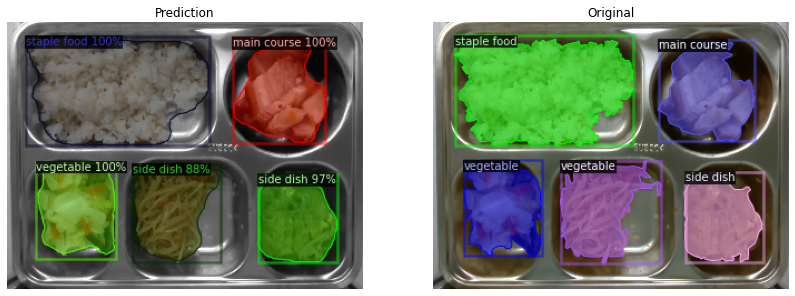

file name:  ./dataset_v2/test/img/20211206_130728.jpg
image number:  12


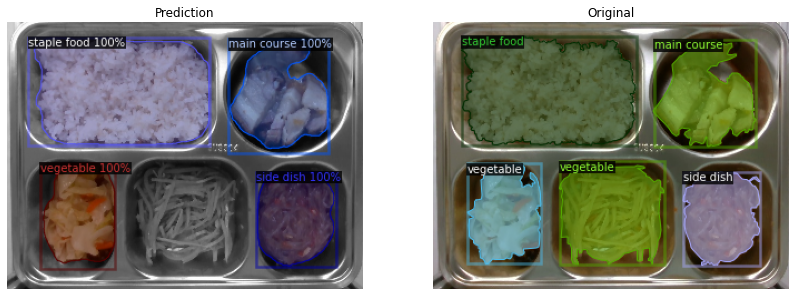

file name:  ./dataset_v2/test/img/20211206_130909.jpg
image number:  13


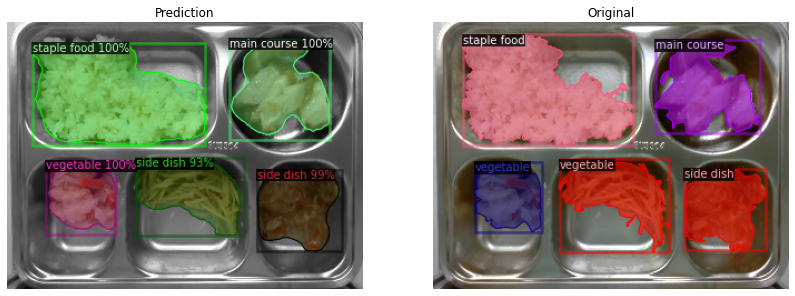

file name:  ./dataset_v2/test/img/20211206_131652.jpg
image number:  14


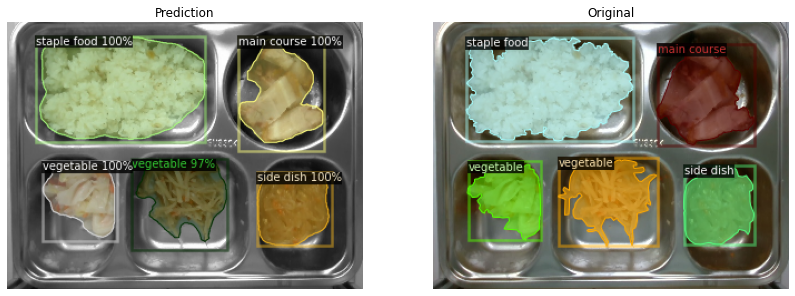

file name:  ./dataset_v2/test/img/20211206_131903.jpg
image number:  15


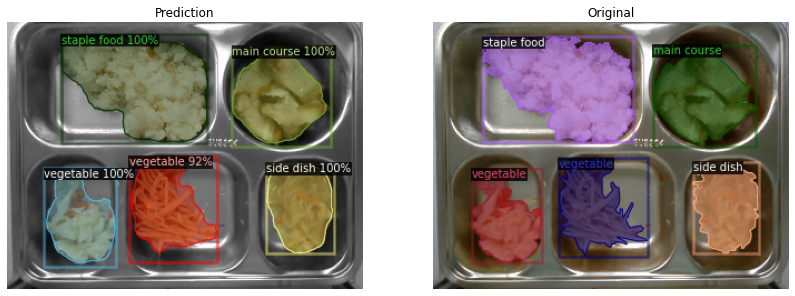

file name:  ./dataset_v2/test/img/20211206_131938.jpg
image number:  16


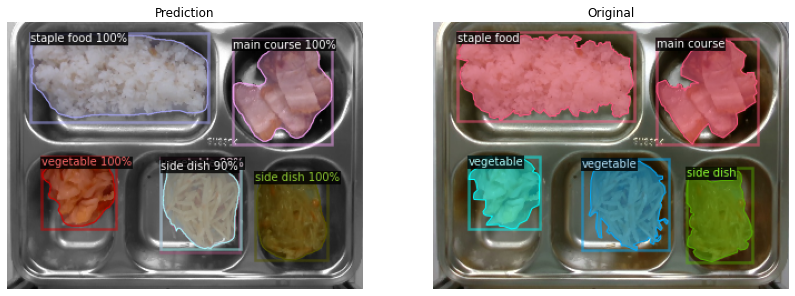

file name:  ./dataset_v2/test/img/20211206_132019.jpg
image number:  17


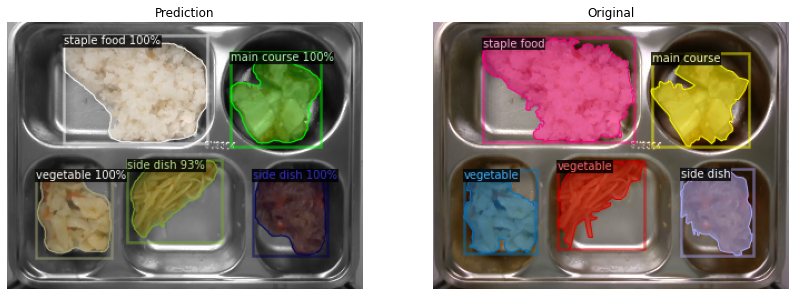

file name:  ./dataset_v2/test/img/20211206_132058.jpg
image number:  18


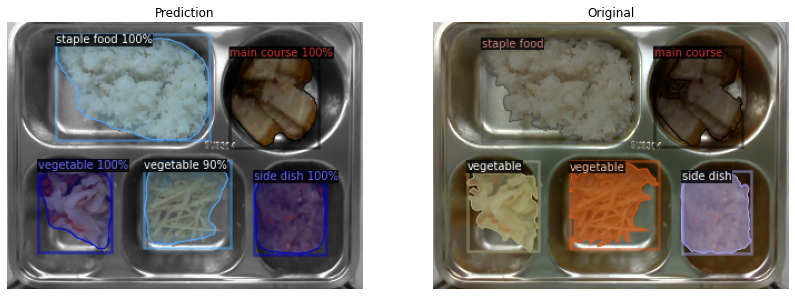

file name:  ./dataset_v2/test/img/20211206_132437.jpg
image number:  19


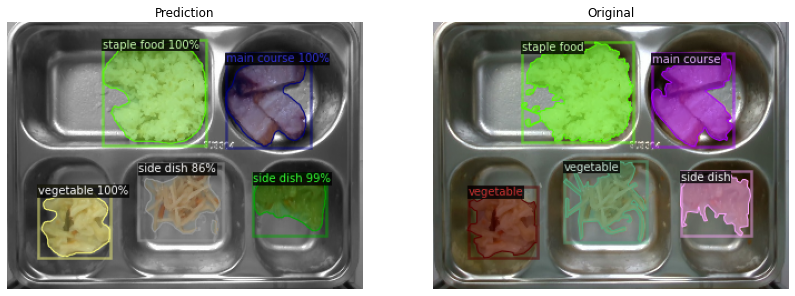

file name:  ./dataset_v2/test/img/20211206_133402.jpg
image number:  20


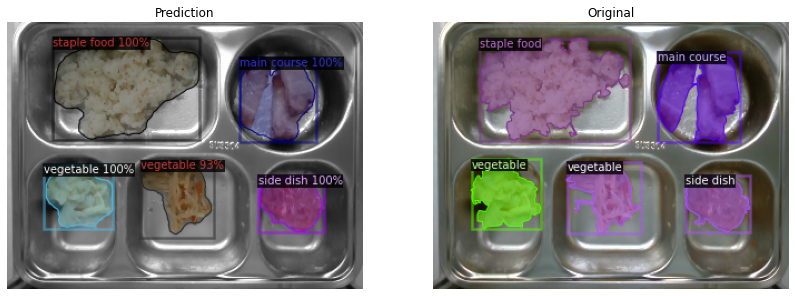

file name:  ./dataset_v2/test/img/20211206_133641.jpg
image number:  21


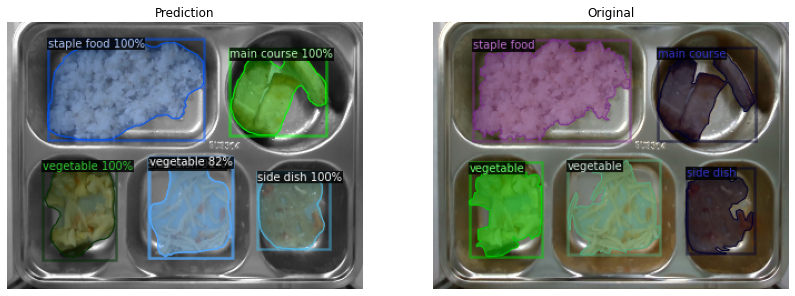

file name:  ./dataset_v2/test/img/20211206_133713.jpg
image number:  22


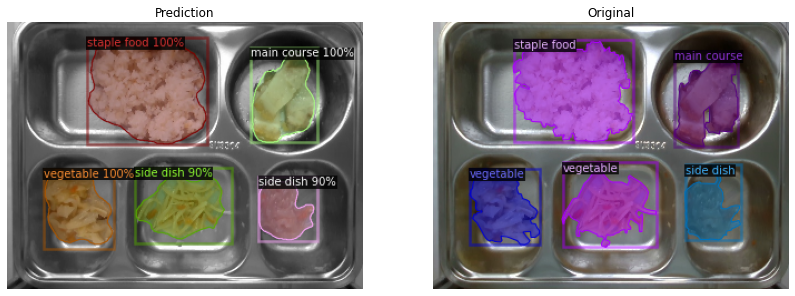

file name:  ./dataset_v2/test/img/20211206_133732.jpg
image number:  23


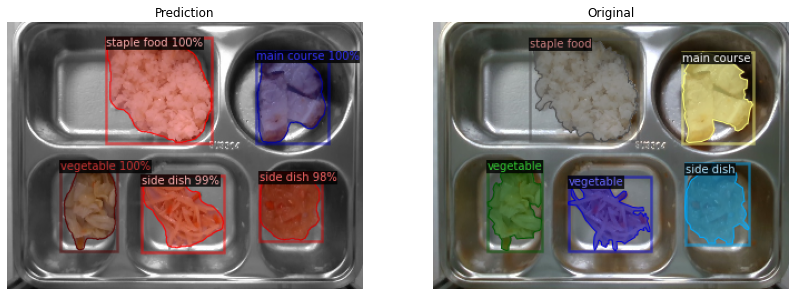

file name:  ./dataset_v2/test/img/20211206_133757.jpg
image number:  24


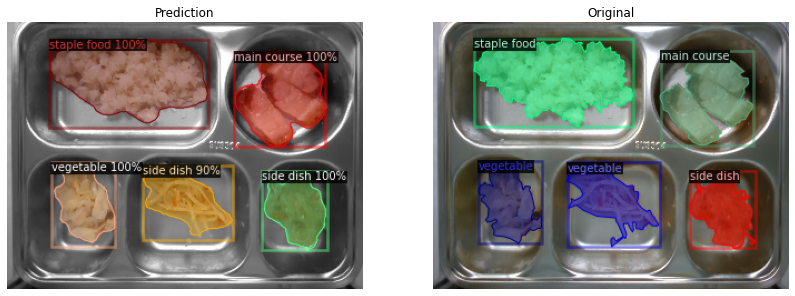

file name:  ./dataset_v2/test/img/20221123175231_271_0.jpg
image number:  25


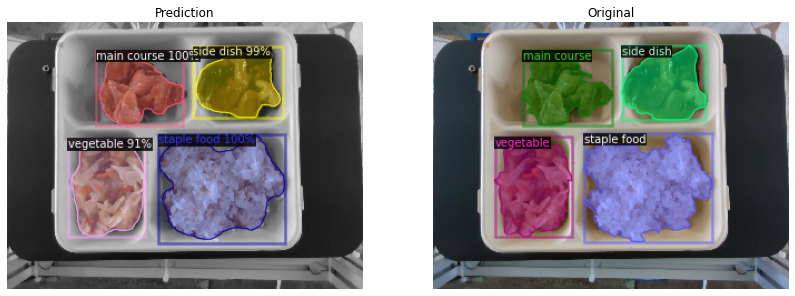

file name:  ./dataset_v2/test/img/20221123180310_288_0.jpg
image number:  26


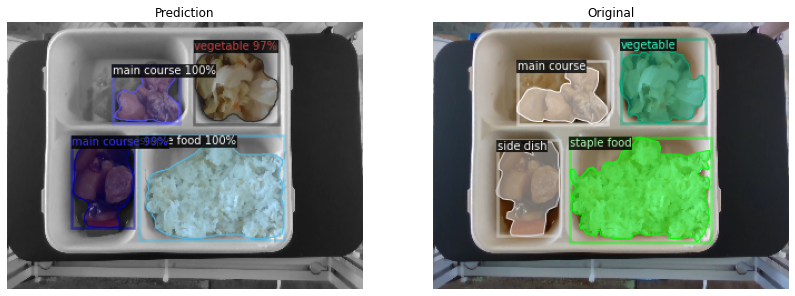

file name:  ./dataset_v2/test/img/20221123180337_289_0.jpg
image number:  27


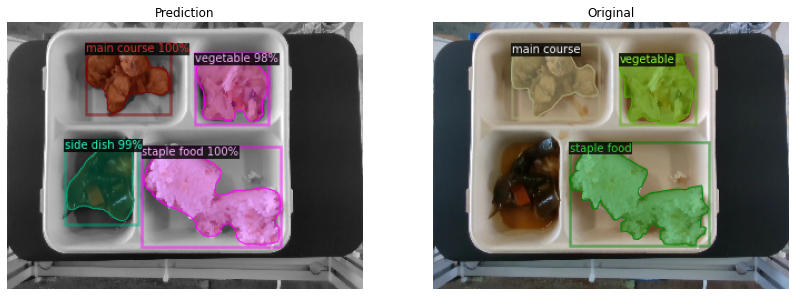

file name:  ./dataset_v2/test/img/20221123180351_290_0.jpg
image number:  28


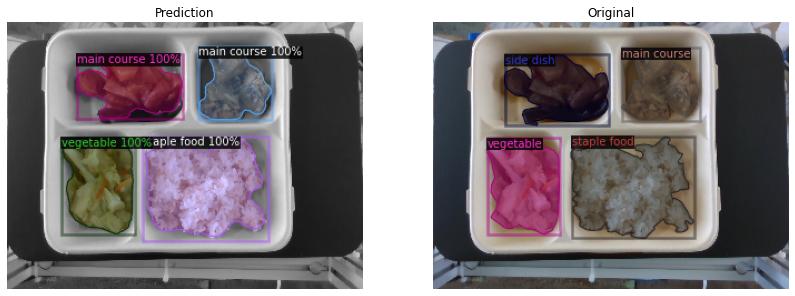

file name:  ./dataset_v2/test/img/20221123181057_269_1.jpg
image number:  29


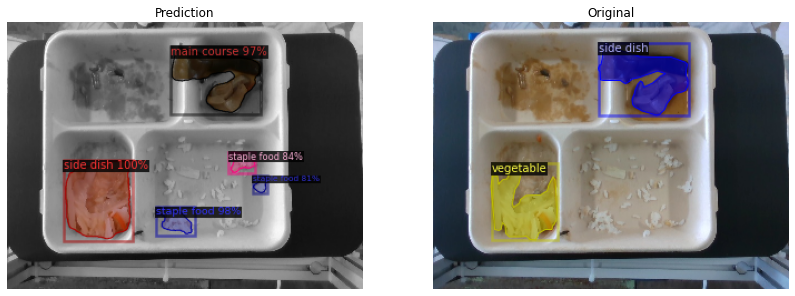

file name:  ./dataset_v2/test/img/20221123181807_273_1.jpg
image number:  30


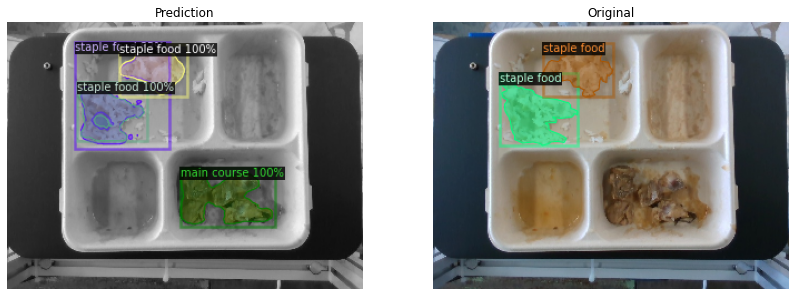

file name:  ./dataset_v2/test/img/20221123181950_277_0.jpg
image number:  31


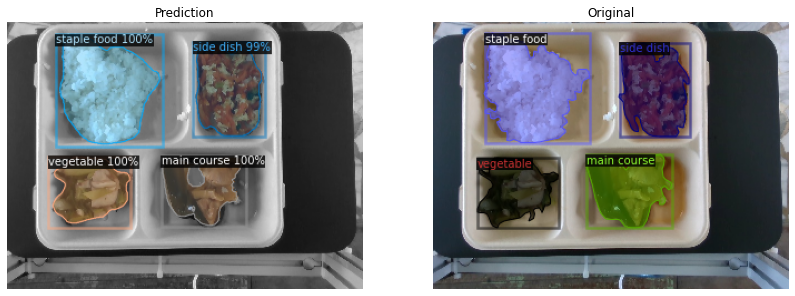

file name:  ./dataset_v2/test/img/20221123181959_357_0.jpg
image number:  32


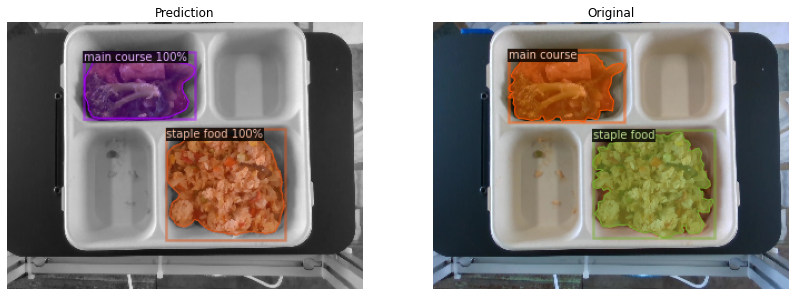

file name:  ./dataset_v2/test/img/20221123182039_279_0.jpg
image number:  33


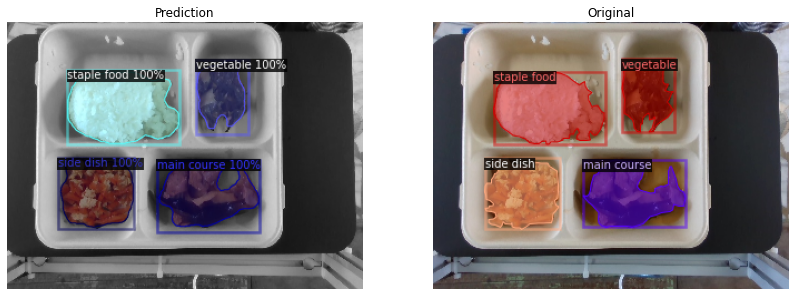

file name:  ./dataset_v2/test/img/20221123182144_357_0.jpg
image number:  34


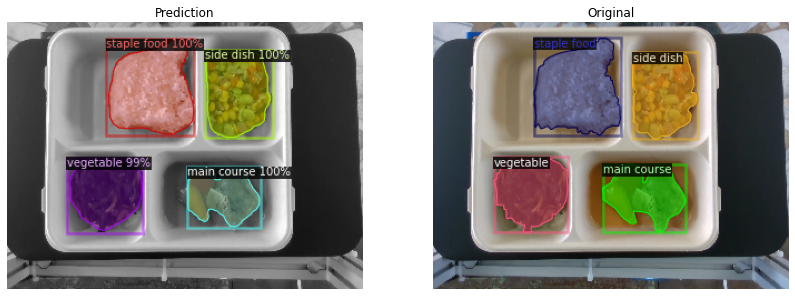

file name:  ./dataset_v2/test/img/20221123182149_278_0.jpg
image number:  35


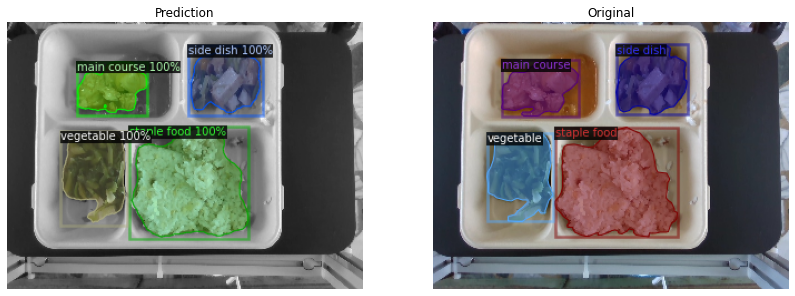

file name:  ./dataset_v2/test/img/20221123182258_281_0.jpg
image number:  36


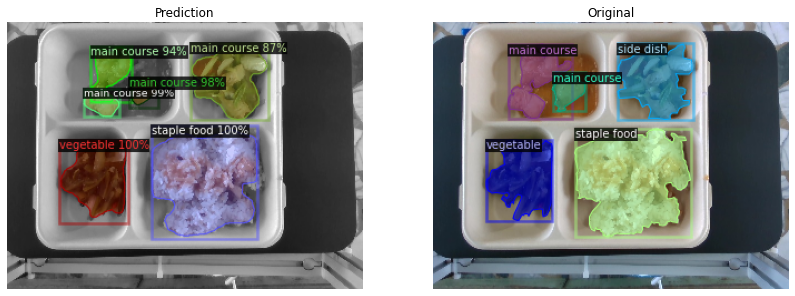

file name:  ./dataset_v2/test/img/20221123182349_274_0.jpg
image number:  37


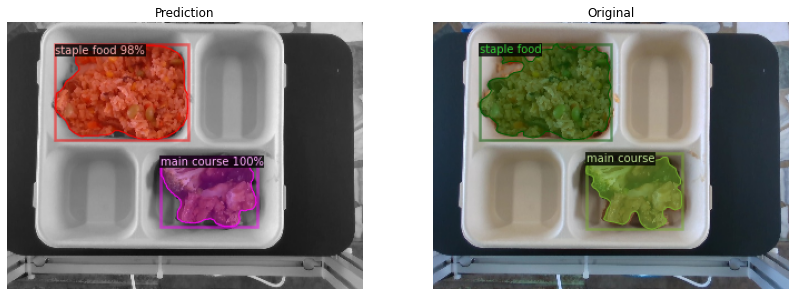

file name:  ./dataset_v2/test/img/20221123182503_278_0.jpg
image number:  38


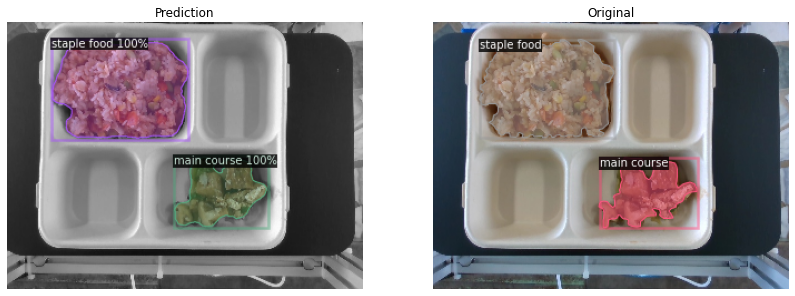

file name:  ./dataset_v2/test/img/20221123182627_275_0.jpg
image number:  39


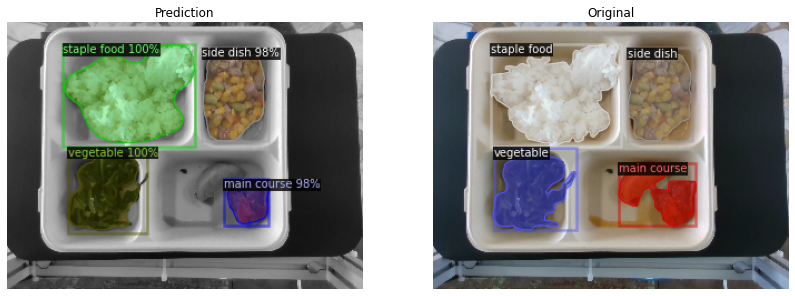

file name:  ./dataset_v2/test/img/20221123182627_290_0.jpg
image number:  40


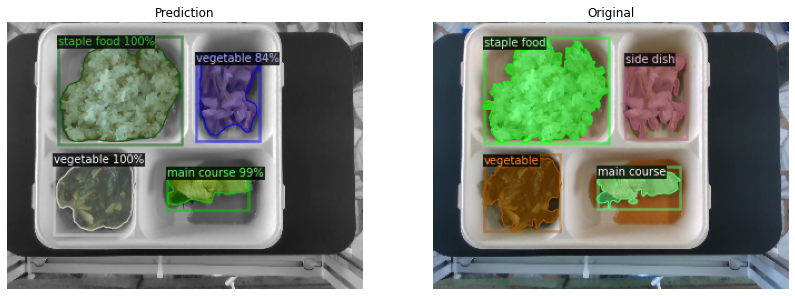

file name:  ./dataset_v2/test/img/20221123182702_291_0.jpg
image number:  41


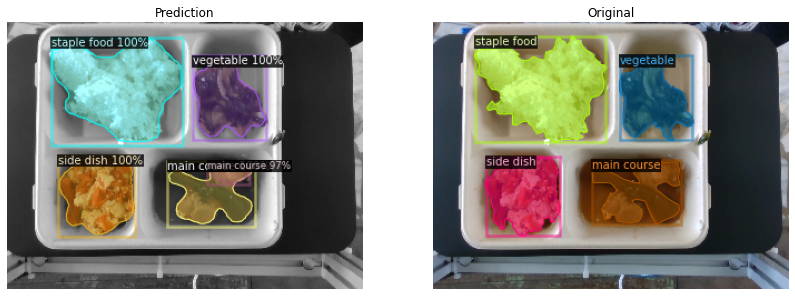

file name:  ./dataset_v2/test/img/20221123182733_292_0.jpg
image number:  42


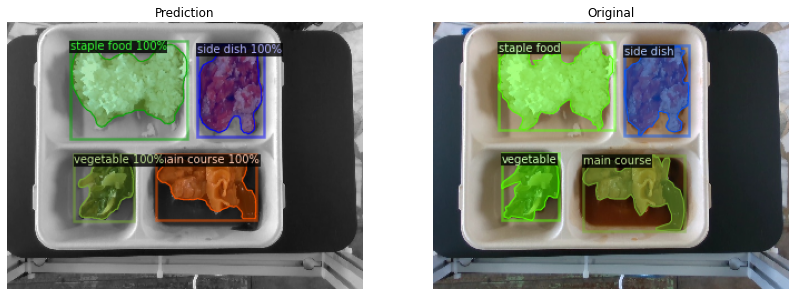

file name:  ./dataset_v2/test/img/20221123182811_267_0.jpg
image number:  43


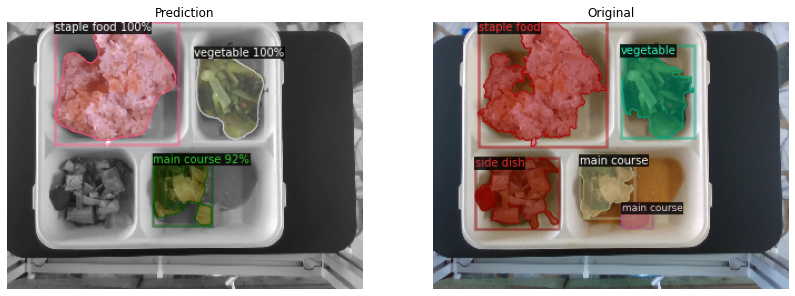

file name:  ./dataset_v2/test/img/20221123182813_287_0.jpg
image number:  44


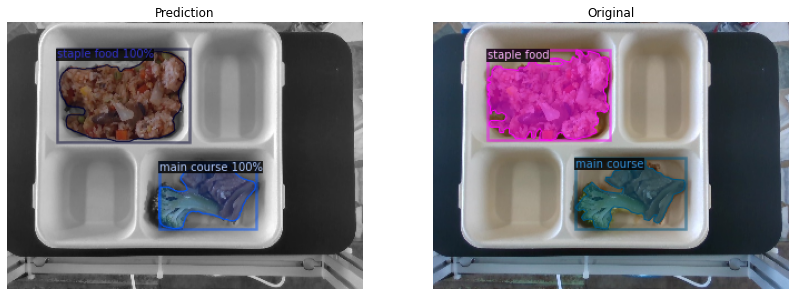

file name:  ./dataset_v2/test/img/20221123182906_269_0.jpg
image number:  45


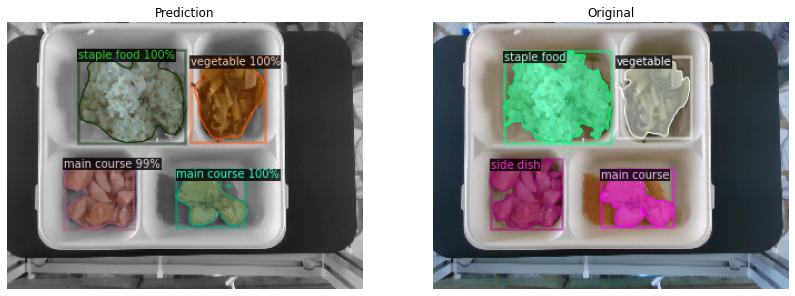

file name:  ./dataset_v2/test/img/20221123182946_270_0.jpg
image number:  46


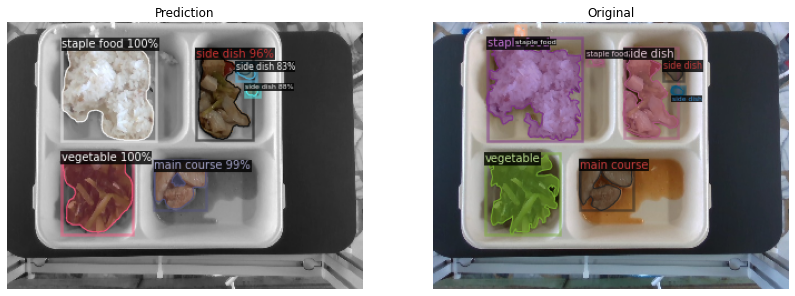

file name:  ./dataset_v2/test/img/20221123183740_272_1.jpg
image number:  47


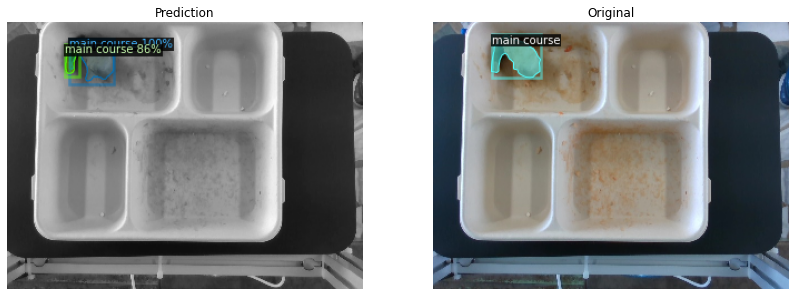

file name:  ./dataset_v2/test/img/20221123183811_287_1.jpg
image number:  48


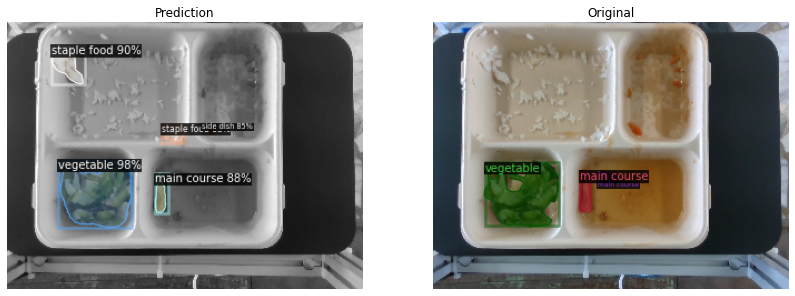

file name:  ./dataset_v2/test/img/20221123184008_279_1.jpg
image number:  49


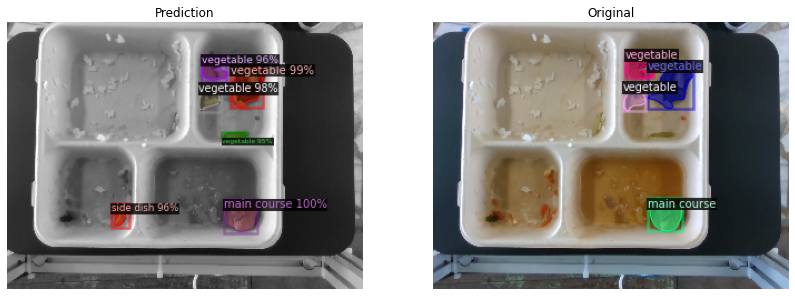

file name:  ./dataset_v2/test/img/20221123184126_269_1.jpg
image number:  50


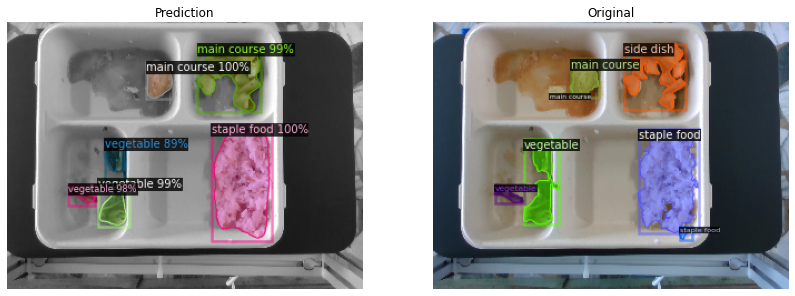

file name:  ./dataset_v2/test/img/20221123184130_287_1.jpg
image number:  51


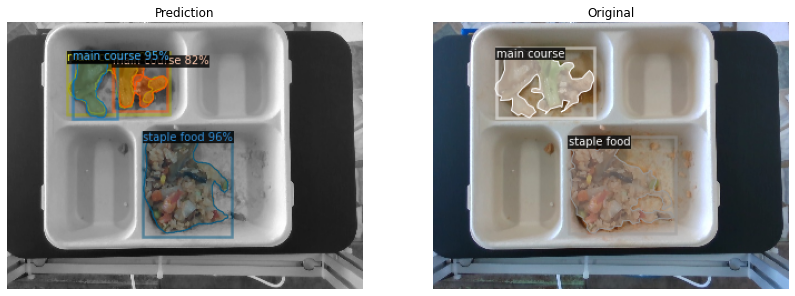

file name:  ./dataset_v2/test/img/20221123184156_274_1.jpg
image number:  52


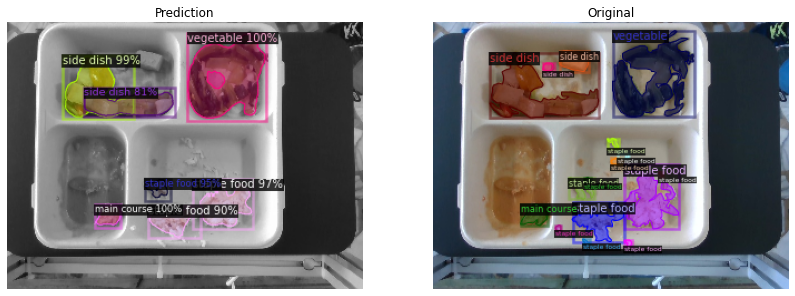

file name:  ./dataset_v2/test/img/20221123184239_291_1.jpg
image number:  53


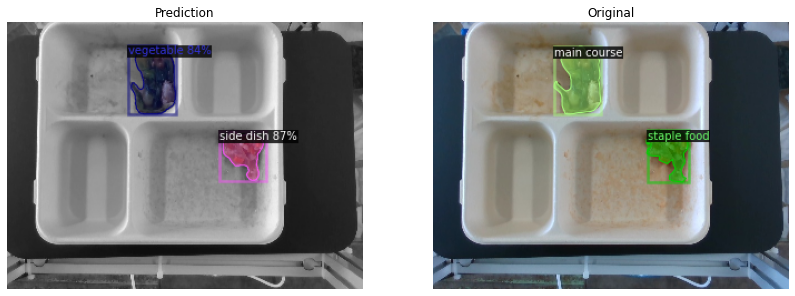

file name:  ./dataset_v2/test/img/20221123184254_288_1.jpg
image number:  54


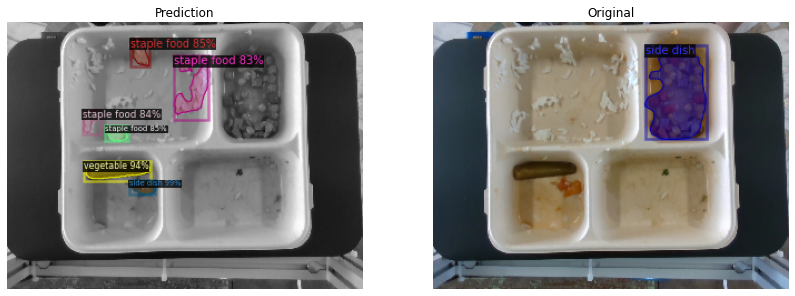

file name:  ./dataset_v2/test/img/20221123184407_283_1.jpg
image number:  55


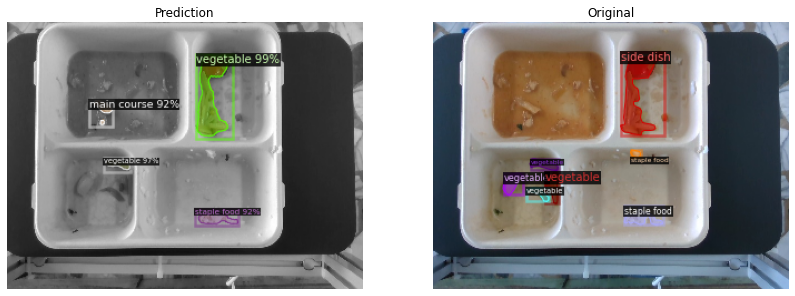

file name:  ./dataset_v2/test/img/20221123184533_269_1.jpg
image number:  56


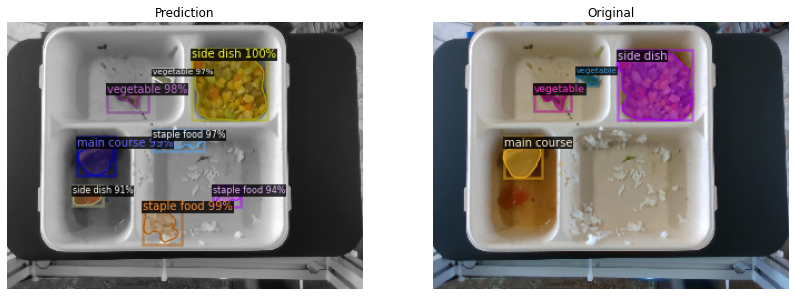

file name:  ./dataset_v2/test/img/20221123184644_280_1.jpg
image number:  57


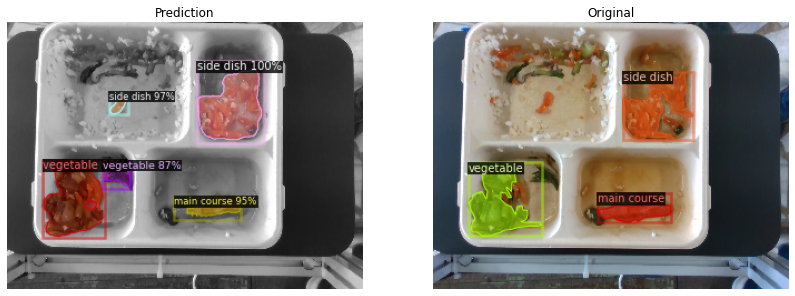

file name:  ./dataset_v2/test/img/20221123184723_266_1.jpg
image number:  58


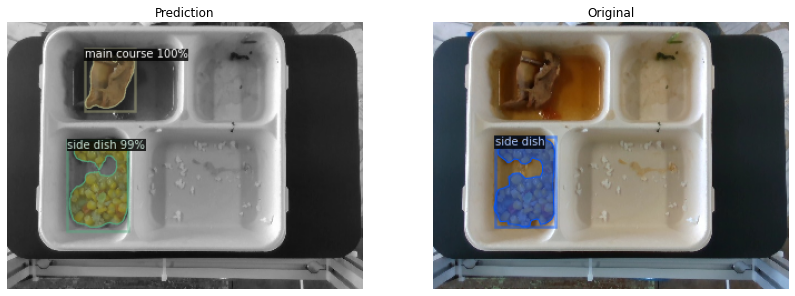

file name:  ./dataset_v2/test/img/20221123184926_290_1.jpg
image number:  59


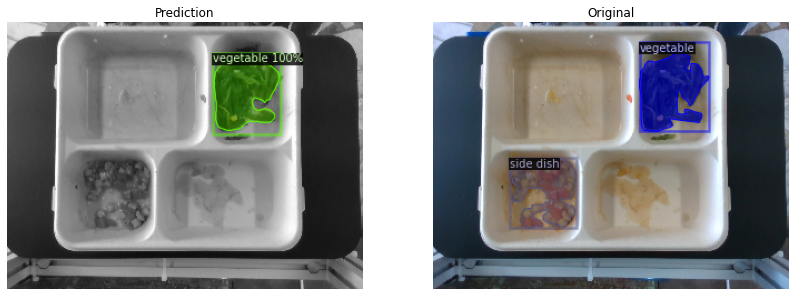

file name:  ./dataset_v2/test/img/20221123185029_283_1.jpg
image number:  60


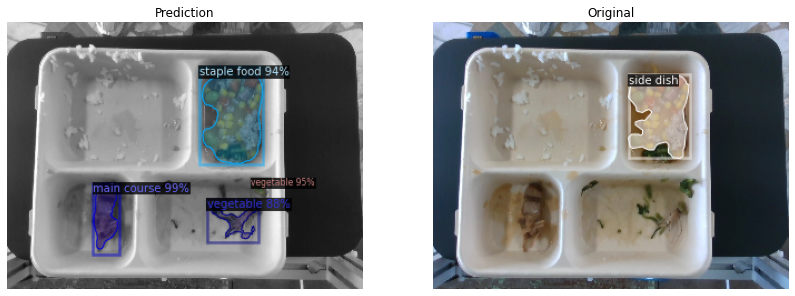

file name:  ./dataset_v2/test/img/20221128120737_358_0.jpg
image number:  61


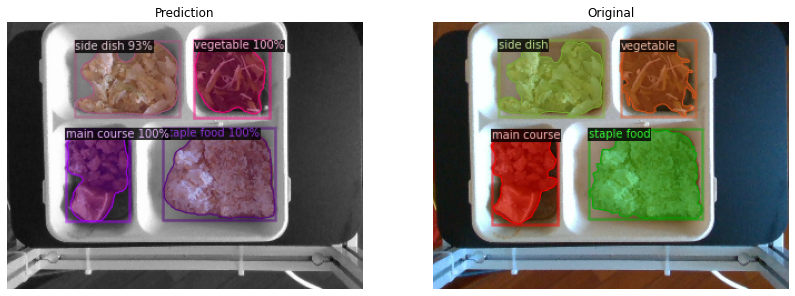

file name:  ./dataset_v2/test/img/20221128120857_296_0.jpg
image number:  62


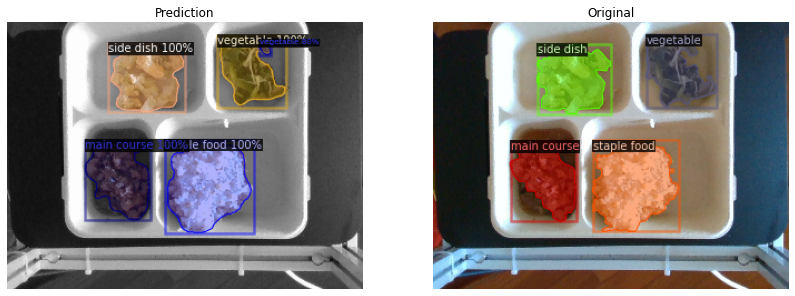

file name:  ./dataset_v2/test/img/20221128120903_377_0.jpg
image number:  63


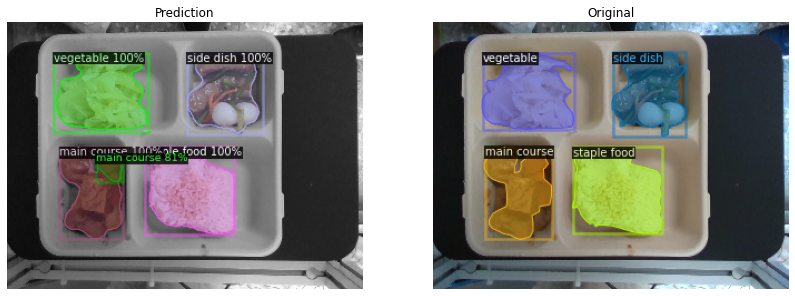

file name:  ./dataset_v2/test/img/20221128120924_340_0.jpg
image number:  64


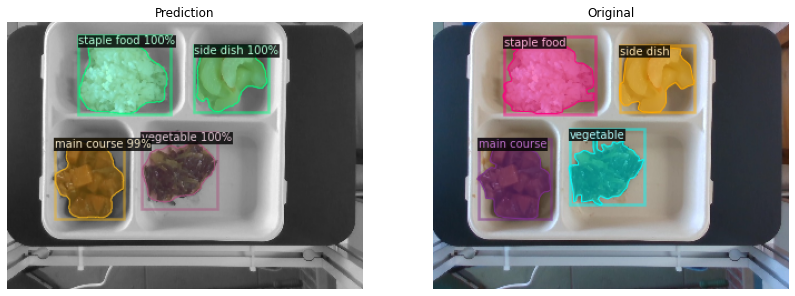

file name:  ./dataset_v2/test/img/20221128121009_383_0.jpg
image number:  65


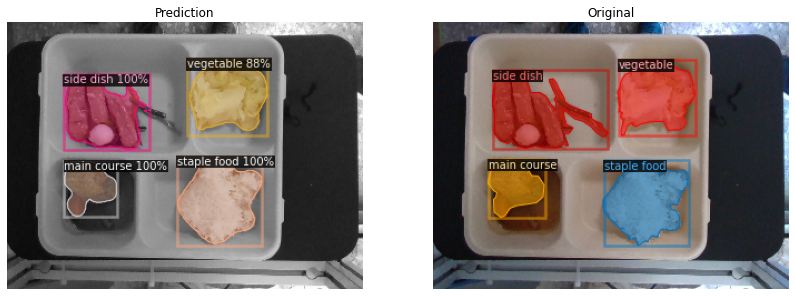

file name:  ./dataset_v2/test/img/20221128121056_308_0.jpg
image number:  66


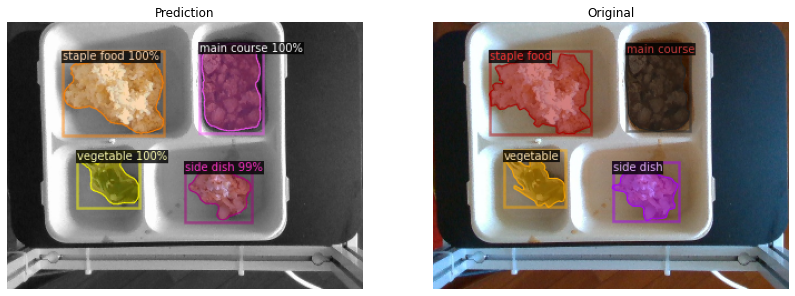

file name:  ./dataset_v2/test/img/20221128121129_311_0.jpg
image number:  67


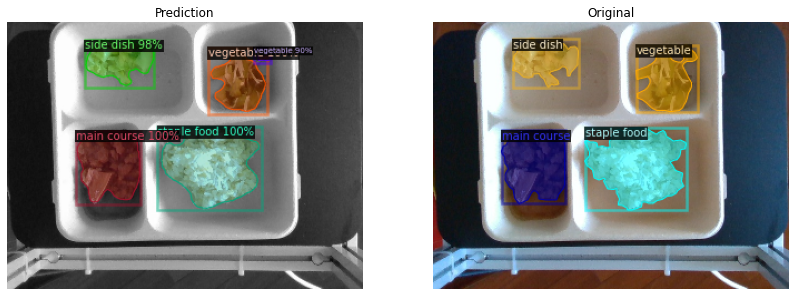

file name:  ./dataset_v2/test/img/20221128121129_329_0.jpg
image number:  68


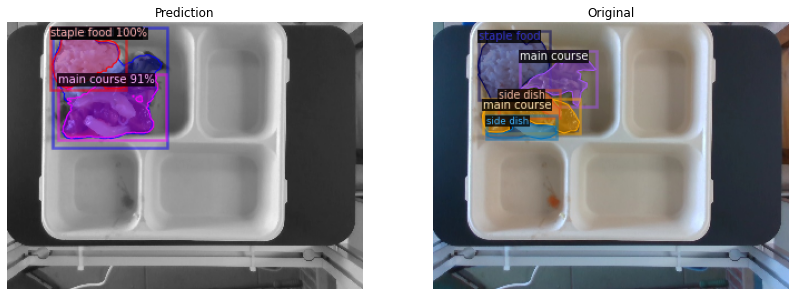

In [ ]:
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.visualizer import Visualizer
from detectron2.data.datasets import register_coco_instances
from detectron2.data import MetadataCatalog, DatasetCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
import os, random
from matplotlib import pyplot as plt
cfg = get_cfg()
cfg.merge_from_file("/content/drive/MyDrive/Colab/類神經/期末專題/output/MaskRCNN_R101_7000/output.yaml")  #output的.yaml檔
cfg.MODEL.WEIGHTS = "/content/drive/MyDrive/Colab/類神經/期末專題/output/MaskRCNN_R101_7000/model_final.pth"  #weight檔
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # 設定THRESHOLD，越高AP越低
predictor = DefaultPredictor(cfg)
test_ann_path = r'./dataset_v2/test/dataset.json'
test_img_path = r'./dataset_v2/test/img'

assert os.path.isfile(test_ann_path), f'Training annotation file not found: {test_ann_path}'
assert os.path.isdir(test_img_path), f'Training image directory not found: {test_img_path}'

register_coco_instances("dish_test", {}, test_ann_path, test_img_path) #跑第二次要註解
dataset_dicts = DatasetCatalog.get("dish_test")
dish_metadata = MetadataCatalog.get("dish_test")
count=1
for file_name in dataset_dicts:
  print('file name: ',file_name["file_name"])
  print('image number: ',count)
  count+=1
  im = cv2.imread(file_name["file_name"])

  plt.figure(figsize=(14, 9))
  plt.subplot(1, 2, 1)
  plt.axis("off")
  plt.title(f"Prediction")
  outputs_1 = predictor(im)
  v = Visualizer(im[:, :, ::-1],
          metadata=dish_metadata, 
          scale=0.5, 
          instance_mode=ColorMode.IMAGE_BW
  )
  out_1 = v.draw_instance_predictions(outputs_1["instances"].to("cpu"))
  plt.imshow(out_1.get_image())

  plt.subplot(1, 2, 2)
  plt.axis("off")
  plt.title(f"Original")
  visualizer = Visualizer(im[:, :, ::-1], metadata=dish_metadata, scale=0.5)
  out_2 = visualizer.draw_dataset_dict(file_name)
  plt.imshow(out_2.get_image())
  plt.show()

# Loss and Result

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/Colab/類神經/期末專題/output

<IPython.core.display.Javascript object>

In [ ]:
import os
file_list = os.listdir('/content/drive/MyDrive/Colab/類神經/期末專題/result')
evaluation_list={}
for name in file_list:
  if 'result' in name:
    data_name = '/content/drive/MyDrive/Colab/類神經/期末專題/result/'+name
    # Load result file
    cocoDt = cocoGt.loadRes(data_name)

    # Evaluate
    cocoEval = COCOeval(cocoGt, cocoDt)
    cocoEval.evaluate()
    cocoEval.accumulate()

    original_stdout = sys.stdout
    string_stdout = StringIO()
    sys.stdout = string_stdout
    cocoEval.summarize()
    sys.stdout = original_stdout

    # Please submit your results
    detail = string_stdout.getvalue()
    evaluation_list[name]=detail

Loading and preparing results...
DONE (t=0.74s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.26s).
Accumulating evaluation results...
DONE (t=0.06s).
Loading and preparing results...
DONE (t=0.78s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.34s).
Accumulating evaluation results...
DONE (t=0.09s).
Loading and preparing results...
DONE (t=0.84s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.35s).
Accumulating evaluation results...
DONE (t=0.11s).
Loading and preparing results...
DONE (t=0.92s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t=0.45s).
Accumulating evaluation results...
DONE (t=0.11s).
Loading and preparing results...
DONE (t=0.85s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *segm*
DONE (t

KeyboardInterrupt: ignored

In [ ]:
for key in evaluation_list.keys():
  print('Json檔檔名 : ',key)
  print(evaluation_list[key])
  print("  ")